In [1]:
import math
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import scanpy as sc
from tqdm import tqdm
from matplotlib.colors import rgb2hex
import random
from scipy import stats
from scipy.stats import ranksums

In [2]:
from src.loki.tools.loki_cpd import *
from src.loki.tools.pca_fit import *
from src.loki.analysis.alignment_neighbor import *
from src.loki.utilities.stats import *
from src.loki.preprocess.preprocess_ad import *
from src.loki.plotting.alignment_plot import *

In [3]:
def prepare_data(sample_name):
    ad = sc.read_h5ad(os.path.join(data_dir, sample_name+'.h5ad'))
    ad.var_names_make_unique()
    scalef = get_scalefactors(ad)['tissue_hires_scalef']
    ad_coor = np.array(ad.obsm['spatial'])*scalef
    img = ad.uns['spatial'][get_library_id(ad)]['images']['hires']
    if img.max()<1.1:
        img = (img*255).astype('uint8')

    return ad, ad_coor, img

In [4]:
def get_features(sample_name, feature_type, case_name):
    features_path=os.path.join(case_dir_omiclip, sample_name+feature_type+case_name+'.csv')
    features = pd.read_csv(features_path, index_col=0, header = None)

    return features

In [5]:
import paste 
import matplotlib.patches as mpatches
from matplotlib import style
import matplotlib as mpl

def paste_align(src_sample_name):
    
    ad_tar_paste = sc.read_h5ad(os.path.join(data_dir, tar_sample_name+'.h5ad'))
    ad_tar_paste.var_names_make_unique()
    sc.pp.filter_genes(ad_tar_paste, min_counts = 15)
    sc.pp.filter_cells(ad_tar_paste, min_counts = 100)
    del ad_tar_paste.uns
    
    ad_src_paste = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
    ad_src_paste.var_names_make_unique()
    sc.pp.filter_genes(ad_src_paste, min_counts = 15)
    sc.pp.filter_cells(ad_src_paste, min_counts = 100)
    del ad_src_paste.uns
    
    pi12 = paste.pairwise_align(ad_tar_paste, ad_src_paste)
    
    # To visualize the alignment you can stack the slices 
    # according to the alignment pi
    slices, pis = [ad_tar_paste, ad_src_paste], [pi12]
    new_slices = paste.stack_slices_pairwise(slices, pis)

    
    slice_colors = ['#e41a1c','#377eb8']
    plt.figure(figsize=(5,5))
    for i in range(len(new_slices)):
        paste.plot_slice(new_slices[i],slice_colors[i],s=50)
    plt.legend(handles=[mpatches.Patch(color=slice_colors[0], label='1'),mpatches.Patch(color=slice_colors[1], label='2')])
    # plt.gca().invert_yaxis()
    # plt.axis('off')
    # plt.savefig(save_path+'paste_aligment.pdf')
    plt.show()
    
    new_slices[0].write_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
    new_slices[1].write_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')

2024-08-27 22:36:31.799453: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/cv2/../../lib64:/cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-27 22:36:31.799600: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/cv2/../../lib64:/cm/shared/apps/slurm/current/lib64/slurm:/cm/shared/apps/slurm/current/lib64
2024-08-27 22:36:31.799611: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If 

In [6]:
data_dir = '/condo/wanglab/shared/wxc/clip/data/human/ST_data/data31_spatial_fresh_frozen_35sample/'

In [7]:
case_dir = '/condo/wanglab/shared/wxc/clip/data/human/ST_data/simulation_data/case_study/data31_spatial_fresh_frozen_35sample/'

In [8]:
case_dir_omiclip = case_dir+'omiclip/'
if not os.path.exists(case_dir_omiclip):
    os.makedirs(case_dir_omiclip)

In [9]:
paste_path = case_dir+'paste/'

In [10]:
tar_sample_name = 'V10F24-050_A1'
ad_tar, ad_tar_coor, tar_img =  prepare_data(tar_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [11]:
gene_num=500

### Generate data for finetune

In [62]:
datapath='/condo/wanglab/shared/wxc/clip/data/human/ST_data/all_top50_heg_remove_dots_dash_hk_genes_no_comma_train_2157867.csv'
DATAFRAME = pd.read_csv(datapath,index_col=0)
target_df=DATAFRAME[DATAFRAME['sample_name'].isin([tar_sample_name])]
target_df['img_path']='/condo/wanglab/shared/wxc/clip/data/human/ST_data/images/patches/'+target_df['img_idx']+'.png'
target_df

/tmp/ipykernel_2737625/3149266822.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  target_df['img_path']='/condo/wanglab/shared/wxc/clip/data/human/ST_data/images/patches/'+target_df['img_idx']+'.png'


,label,sample_name,dataset,img_idx,img_path
V10F24-050_A1_AAACAAGTATCTCCCA-1,MALAT1 MYL9 DES TPM1 CALD1 CNN1 TAGLN MYL6 CKB...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAAGTATCTCCCA-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACACCAATAACTGC-1,RGS1 LMCD1 ZNF721 CISD2 ERGIC1 CDK1 SERPINA1 P...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACACCAATAACTGC-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACAGCTTTCAGAAG-1,MALAT1 IGKC RPL15 CTSD MXRA8 ACTR2 ARPC4 RPL37...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAGCTTTCAGAAG-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACAGGGTCTATATT-1,MALAT1 RPS12 TCEANC ZNF445 CLEC3B BMPR1B COL1A...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAGGGTCTATATT-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_AAACAGTGTTCCTGGG-1,MALAT1 MYL9 ACTG2 MYH11 DES TAGLN CALD1 TPM2 M...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_AAACAGTGTTCCTGGG-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
...,...,...,...,...,...
V10F24-050_A1_TTGTTGTGTGTCAAGA-1,MALAT1 PRRC2C TPM1 NUCB1 AKR7A2 PNRC2 LDLRAP1 ...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTGTGTGTCAAGA-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_TTGTTTCACATCCAGG-1,MALAT1 MYL9 CALD1 ACTG2 DES TPM1 MYL6 TPM2 TAG...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTTCACATCCAGG-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_TTGTTTCATTAGTCTA-1,MALAT1 MYH11 CALD1 TCEANC CKB C1QA TNS1 MYL6 C...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTTCATTAGTCTA-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...
V10F24-050_A1_TTGTTTCCATACAACT-1,MALAT1 TCEANC RPL10 ITGB1BP1 ARL5A CD24 HNRNPA...,V10F24-050_A1,data31_spatial_fresh_frozen_35sample,V10F24-050_A1_TTGTTTCCATACAACT-1_hires,/condo/wanglab/shared/wxc/clip/data/human/ST_d...


In [63]:
data_dir+tar_sample_name+'_training_df.csv'

'/condo/wanglab/shared/wxc/clip/data/human/ST_data/data31_spatial_fresh_frozen_35sample/V10F24-050_A1_training_df.csv'

In [64]:
target_df.to_csv(data_dir+tar_sample_name+'_training_df.csv')

### Generate finetune features

In [50]:
from open_clip import create_model_from_pretrained, get_tokenizer
import open_clip

In [51]:
PATCH_DIR = "/condo/wanglab/shared/wxc/clip/data/human/ST_data/images/patches/"
DEVICE = "cuda"

In [52]:
tokenizer = get_tokenizer('coca_ViT-L-14')
model_dir = "2024_08_19-20_20_48-model_coca_ViT-L-14-lr_5e-06-b_64-j_8-p_amp"
epoch_n = "epoch_10.pt"
model_path = os.path.join("/condo/wanglab/shared/wxc/clip/models/open_clip-main/logs", model_dir, "checkpoints", epoch_n)
model, preprocess = create_model_from_pretrained("coca_ViT-L-14", device = DEVICE, pretrained=model_path)

In [53]:
house_keeping_genes = pd.read_csv("/condo/wanglab/shared/wxc/clip/data/human/ST_data/housekeeping_genes.csv", index_col = 0)

In [54]:
k=50

In [55]:
def generate_features_finetune10(sample_name):
    ad = sc.read_h5ad(os.path.join(data_dir, sample_name+'.h5ad'))
    ad = ad[:,~ad.var.index.str.contains('.',regex=False)]
    ad = ad[:,~ad.var.index.str.contains('-',regex=False)]
    ad = ad[:,~ad.var.index.isin(house_keeping_genes['genesymbol'])]
    expr = pd.DataFrame(ad.X.todense(), index=ad.obs.index + '_hires', columns=ad.var.index)
    top_k_genes = expr.apply(lambda s, n: pd.Series(s.nlargest(n).index), axis=1, n=k)
    top_k_genes_str = pd.DataFrame()
    top_k_genes_str['label'] = top_k_genes[top_k_genes.columns].astype(str).apply(lambda x: ' '.join(x), axis = 1)
    
    text_feature_path = os.path.join(case_dir_omiclip+sample_name+'_text_feature_finetune10.csv')
    image_feature_path = os.path.join(case_dir_omiclip+sample_name+'_image_feature_finetune10.csv')
    text_features = pd.DataFrame()
    image_features = pd.DataFrame()
    warnings.simplefilter(action='ignore')
    for patch_idx in tqdm(ad.obs.index):
    
        text = top_k_genes_str[top_k_genes_str.index==patch_idx + '_hires']['label'].values[0]
        text_input = tokenizer([text], context_length=76).to(DEVICE)
        with torch.no_grad():
            text_features[patch_idx] = model.encode_text(text_input).cpu().detach().numpy()[0]
    
        image = Image.open(os.path.join(PATCH_DIR, patch_idx+'_hires.png'))
        image_input = torch.stack([preprocess(image)]).to(DEVICE)
        with torch.no_grad():
            image_features[patch_idx] = model.encode_image(image_input).cpu().detach().numpy()[0]
    
    text_features.to_csv(text_feature_path, header=None)
    image_features.to_csv(image_feature_path, header=None)

In [56]:
generate_features_finetune10(tar_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
100%|██████████| 3427/3427 [01:50<00:00, 30.88it/s]


# V10F24-050_B1

In [214]:
src_sample_name = 'V10F24-050_B1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Omiclip ST to ST

In [13]:
case_name = '_coca_after_training20'

In [14]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [15]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

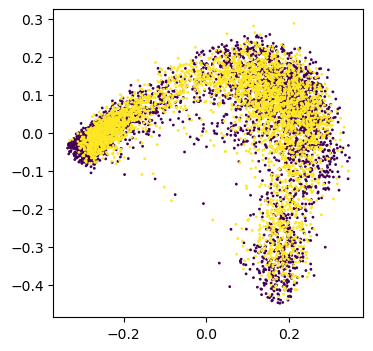

In [16]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [17]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]

In [18]:
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

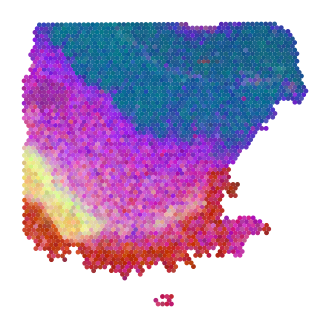

In [19]:
plt.figure(figsize=(4,4))
plt.scatter(ad_tar_coor[:,0], ad_tar_coor[:,1], marker='o', s=6, c=pca_hex_comb[:len(tar_features.T)])
plt.axis('off')
plt.show()

In [20]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [21]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [22]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

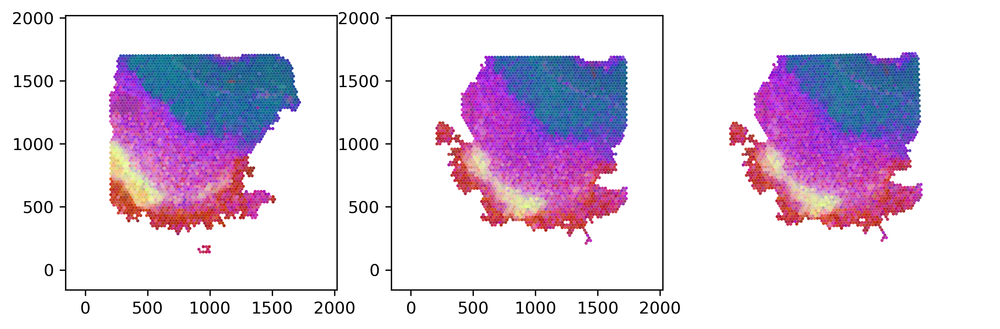

In [23]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

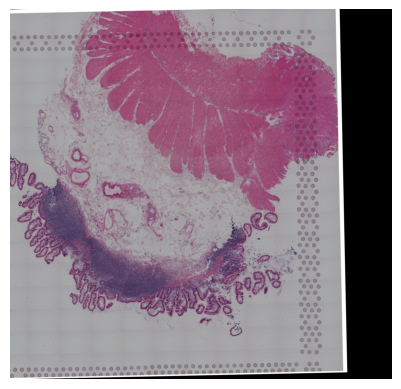

In [46]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [47]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [22]:
# generate_features_finetune10(src_sample_name)

In [24]:
case_name = '_finetune10'

In [25]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [26]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

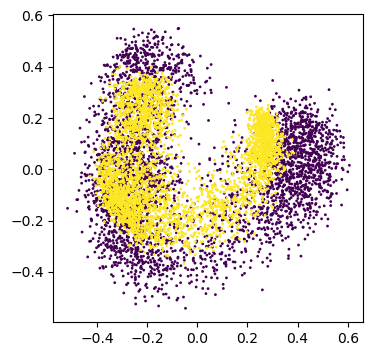

In [27]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [28]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [29]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [30]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

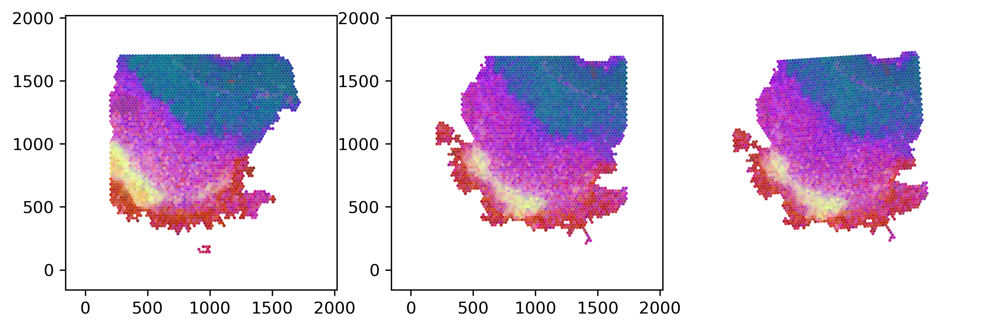

In [31]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

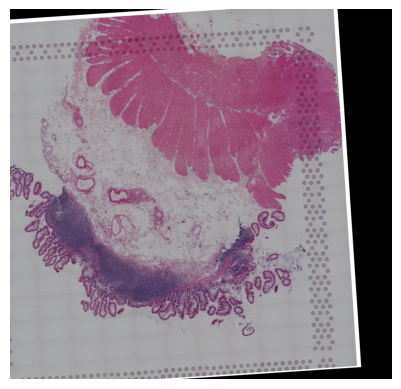

In [66]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [72]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [18]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [19]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


In [20]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


227

In [21]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3333/3333 [00:11<00:00, 287.60it/s]


In [22]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3333/3333 [00:45<00:00, 72.77it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


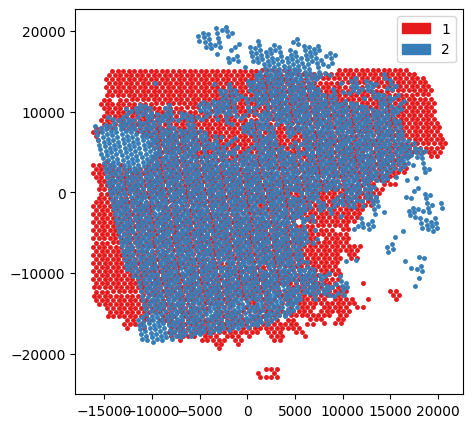

In [99]:
paste_align(src_sample_name)

In [32]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [33]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(184.43812451226228, 1633.8203086912763, 86.54774012448921, 1640.8391455004985)

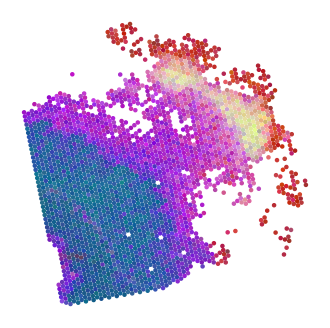

In [34]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [37]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 2581/2581 [00:06<00:00, 370.14it/s]


In [38]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2581/2581 [00:33<00:00, 76.97it/s]


## GPSA

In [38]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')
gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(138.4445077873337, 1741.87524116069, 180.09285735023133, 1776.9082198877109)

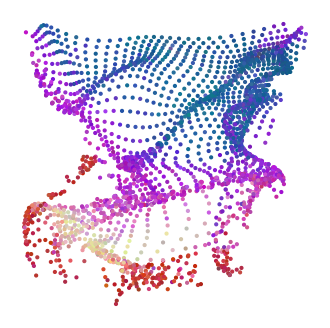

In [39]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)
plt.axis('off')

In [41]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 2607/2607 [00:04<00:00, 597.20it/s]


In [42]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

180

In [43]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 2607/2607 [00:38<00:00, 67.49it/s]


(2355, 2)

## Combine Analysis

In [52]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 180/180 [00:00<00:00, 913.82it/s]


In [53]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.991996,1.004068,0.412279,0.449100
MT-CO3,0.864253,0.858310,0.407918,0.466128
MT-CO1,0.582241,0.577164,0.359282,1.178578
CTSD,0.271413,0.303202,0.277161,0.643414
SERPINA1,0.263962,0.327316,0.307555,0.670798
...,...,...,...,...
BGN,0.014725,0.015538,0.034837,0.042754
LMF2,0.010361,0.009997,0.016435,0.019410
AC037459.4,0.009511,0.011722,0.018911,0.020435
FAM3C,0.008079,0.007808,0.020675,0.010907


In [54]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [215]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

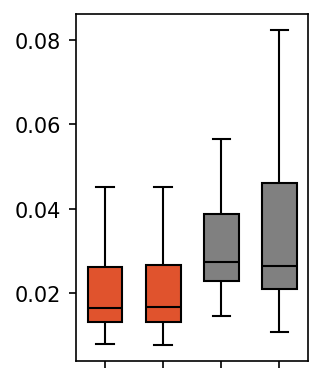

In [216]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey', 'grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [56]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=7.703068065240533, pvalue=6.6418778212407695e-15)

In [57]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=8.367527322413155, pvalue=2.941994143234089e-17)

In [58]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.589505011698881, pvalue=0.27776127559003416)

(0.0, 1.0)

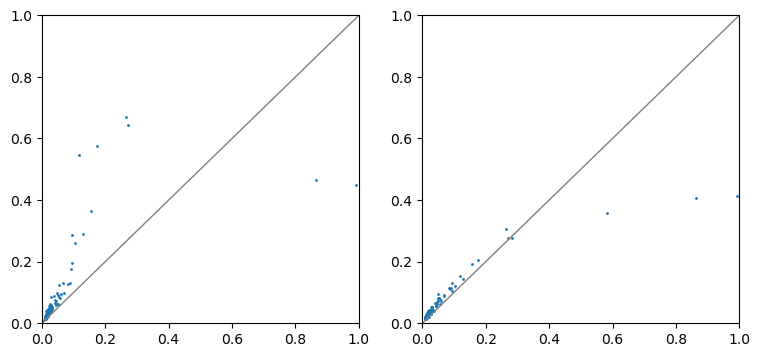

In [59]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-050_C1

In [217]:
src_sample_name = 'V10F24-050_C1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Omiclip ST to ST

In [41]:
case_name = '_coca_after_training20'

In [42]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [43]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

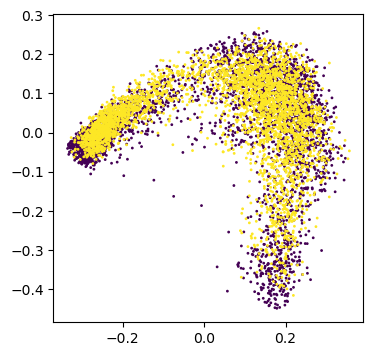

In [44]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [45]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [46]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [47]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [48]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

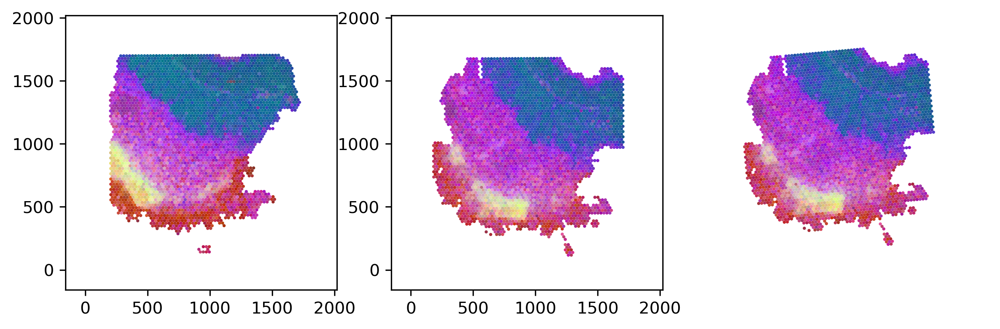

In [49]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

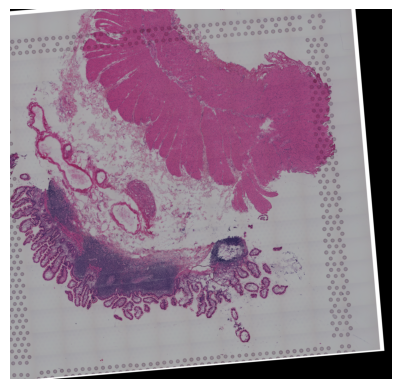

In [310]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [311]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [50]:
# generate_features_finetune10(src_sample_name)

In [51]:
case_name = '_finetune10'

In [52]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [53]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

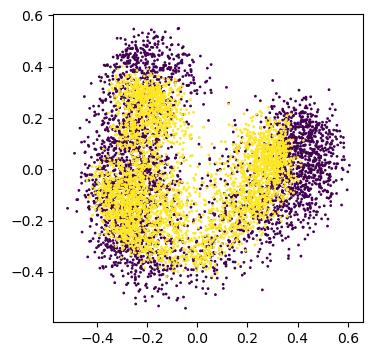

In [54]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [55]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [56]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [57]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

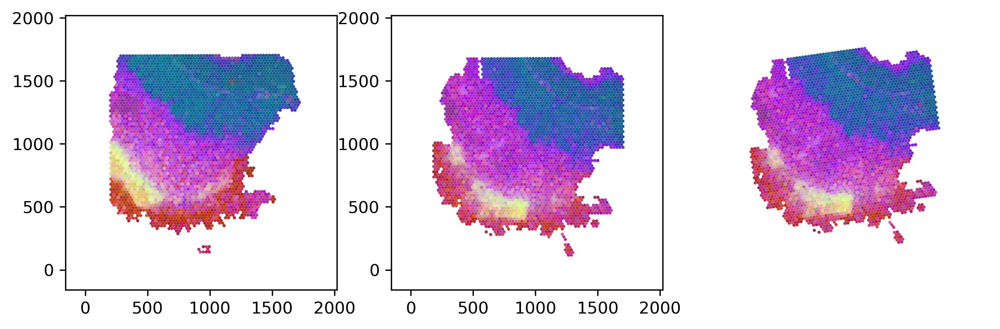

In [58]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

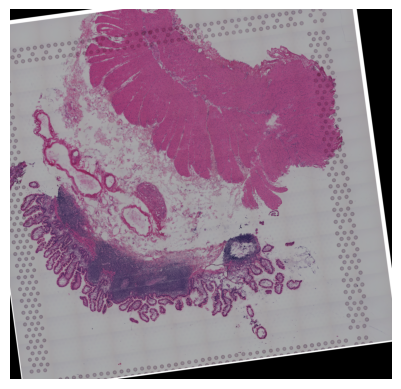

In [337]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [ ]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [66]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [67]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


In [68]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


199

In [69]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3450/3450 [00:11<00:00, 292.26it/s]


In [70]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3450/3450 [00:47<00:00, 72.83it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


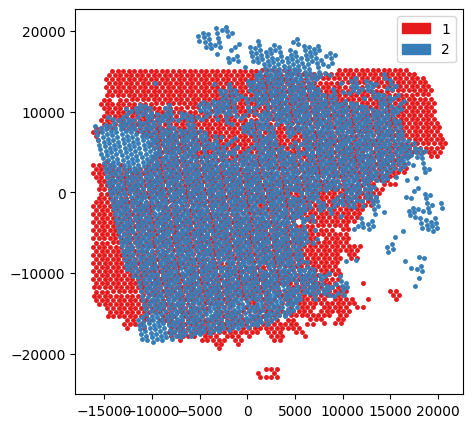

In [99]:
paste_align(src_sample_name)

In [59]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [60]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(91.12460568676353, 1668.0291616342924, 149.1351983084629, 1752.219521788053)

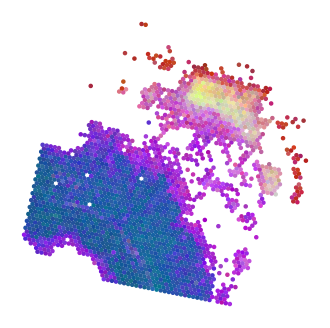

In [61]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[ad_tar.shape[0]:][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [74]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 2266/2266 [00:06<00:00, 370.87it/s]


In [75]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2266/2266 [00:29<00:00, 76.24it/s]


## GPSA

In [1022]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')
gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

FileNotFoundError: [Errno 2] Unable to synchronously open file (unable to open file: name = '/condo/wanglab/shared/wxc/clip/data/human/ST_data/simulation_data/case_study/data31_spatial_fresh_frozen_35sample/gpsa/gpsa_target_V10F24-050_C1.h5ad', errno = 2, error message = 'No such file or directory', flags = 0, o_flags = 0)

In [ ]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)

In [ ]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

In [ ]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

In [ ]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

## Combine Analysis

In [85]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
# gpsa_stat = calculate_rmse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 180/180 [00:00<00:00, 924.96it/s]


In [86]:
gpsa_stat = pd.DataFrame()
gpsa_stat['mse']=None

In [87]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,1.659678,1.650503,NaN,0.400792
MT-CO3,1.442106,1.444070,NaN,0.410920
MT-CO1,0.831629,0.848158,NaN,1.284690
CTSD,0.356105,0.366317,NaN,0.573640
SERPINA1,0.358566,0.385949,NaN,0.642444
...,...,...,...,...
BGN,0.012789,0.012593,NaN,0.042845
LMF2,0.009355,0.010171,NaN,0.019270
AC037459.4,0.008859,0.010106,NaN,0.024411
FAM3C,0.007618,0.007421,NaN,0.015898


In [88]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [205]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

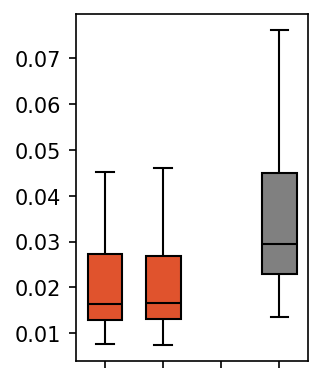

In [213]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey','grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [90]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=8.862833079665307, pvalue=3.9003164773286477e-19)

In [91]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=nan, pvalue=nan)

In [92]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.27145591604003455, pvalue=0.39302020052117803)

(0.0, 1.0)

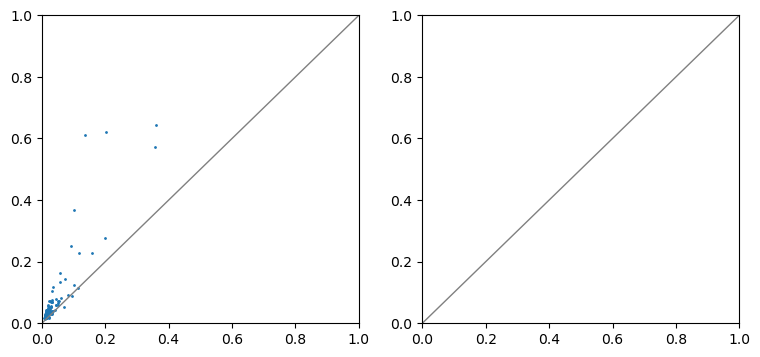

In [93]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-050_D1

In [218]:
src_sample_name = 'V10F24-050_D1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Omiclip ST to ST

In [63]:
case_name = '_coca_after_training20'

In [64]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [65]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

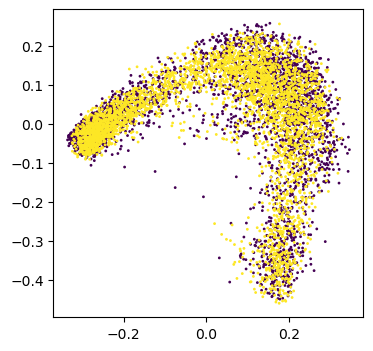

In [66]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [67]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [68]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [69]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [70]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

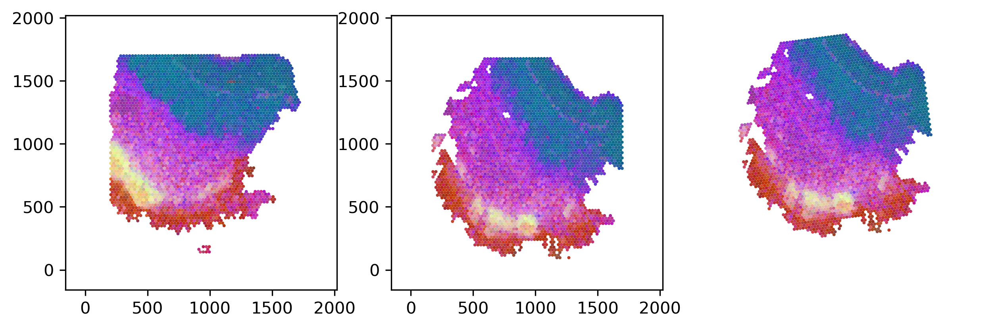

In [71]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

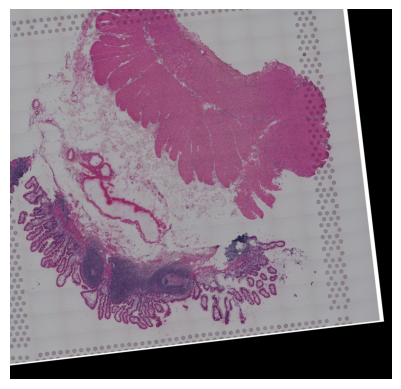

In [155]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [156]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [52]:
# generate_features_finetune10(src_sample_name)

In [72]:
case_name = '_finetune10'

In [73]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [74]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

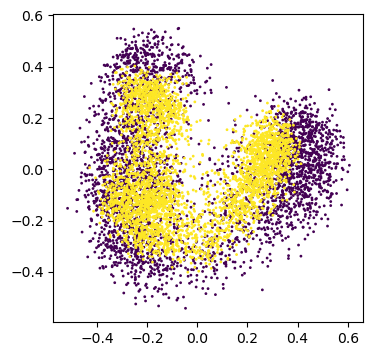

In [75]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [76]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [77]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [78]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

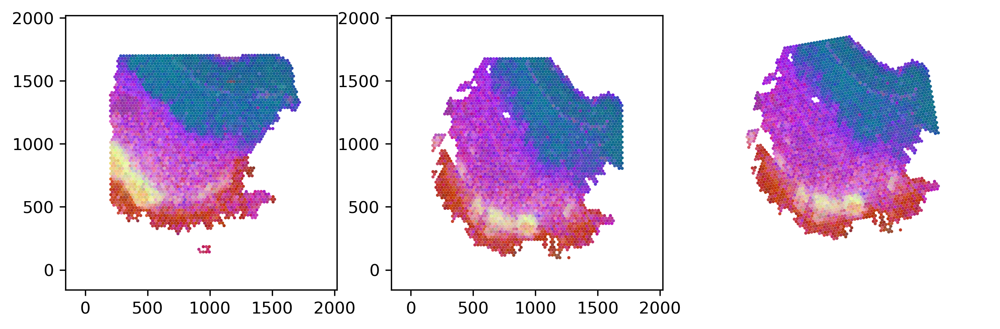

In [79]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

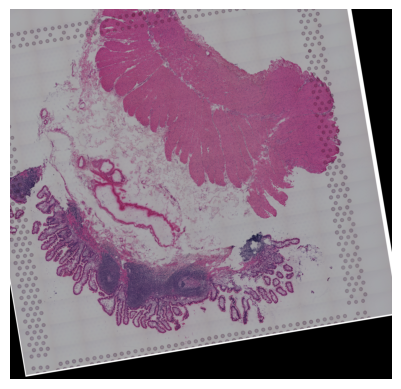

In [166]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [167]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [100]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [101]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [102]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


263

In [103]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3565/3565 [00:12<00:00, 293.69it/s]


In [104]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3565/3565 [00:48<00:00, 73.07it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


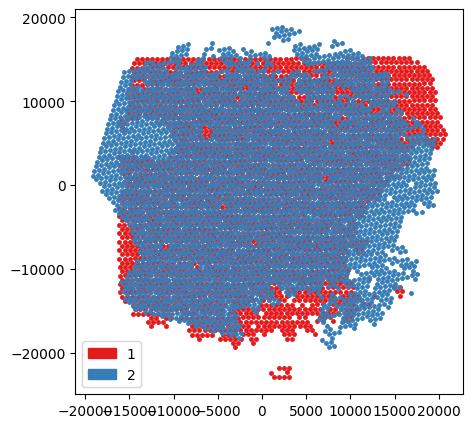

In [174]:
paste_align(src_sample_name)

In [80]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [81]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(62.900139496006474, 1616.1609329213388, 59.62809732041069, 1580.4948827550274)

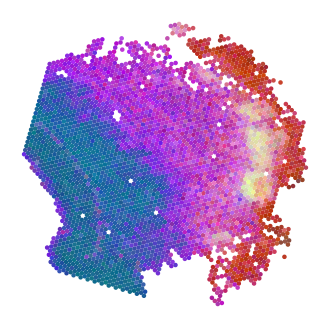

In [82]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [108]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3414/3414 [00:09<00:00, 352.46it/s]


In [109]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3414/3414 [00:44<00:00, 76.45it/s]


## GPSA

In [83]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(55.312275473545185,
 1755.8698888851902,
 215.65914088948776,
 1581.3314025483428)

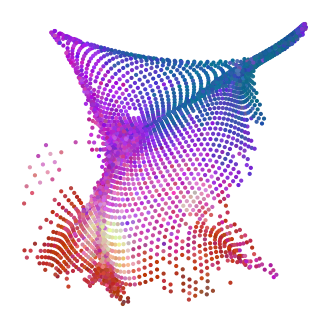

In [84]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)
plt.axis('off')

In [112]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3422/3422 [00:05<00:00, 598.58it/s]


In [113]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

221

In [114]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3422/3422 [00:50<00:00, 67.78it/s]


(3315, 2)

## Combine Analysis

In [123]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 221/221 [00:00<00:00, 869.28it/s]


In [124]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.401670,0.408912,0.500631,0.544779
MT-CO3,0.378585,0.381368,0.528320,0.552180
CD74,0.443419,0.473573,0.604009,0.832430
CTSD,0.216822,0.266493,0.222593,0.611410
SERPINA1,0.299202,0.378279,0.246266,0.728864
...,...,...,...,...
FAM3C,0.008765,0.008247,0.015521,0.011452
TMEM159,0.009557,0.010681,0.012769,0.013537
DNAJC4,0.009391,0.008541,0.017428,0.011843
TADA3,0.010643,0.010504,0.012542,0.012552


In [125]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [219]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

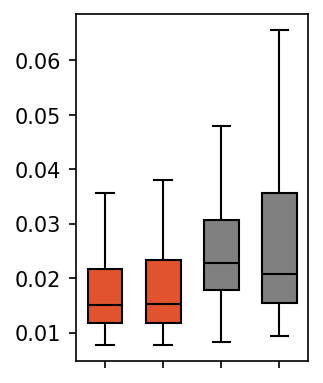

In [220]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey', 'grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [127]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.952966869190826, pvalue=1.3166230986734018e-09)

In [128]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=7.293473576458417, pvalue=1.5103199190515103e-13)

In [129]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.3928429378242523, pvalue=0.34721774455404286)

(0.0, 1.0)

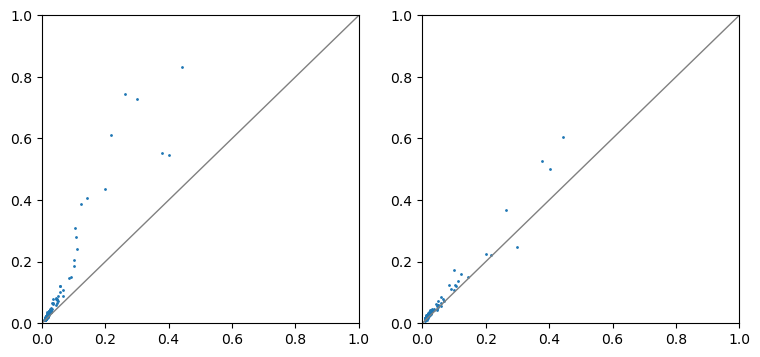

In [130]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_C1

In [188]:
src_sample_name = 'V10F24-048_C1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Omiclip ST to ST

In [86]:
case_name = '_coca_after_training20'

In [87]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [88]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

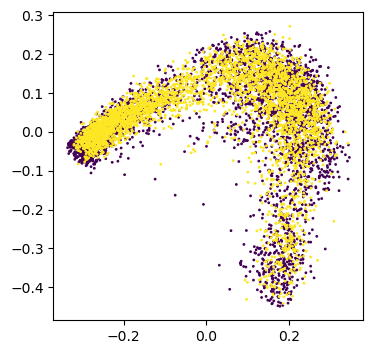

In [89]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [90]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [91]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [92]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [93]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

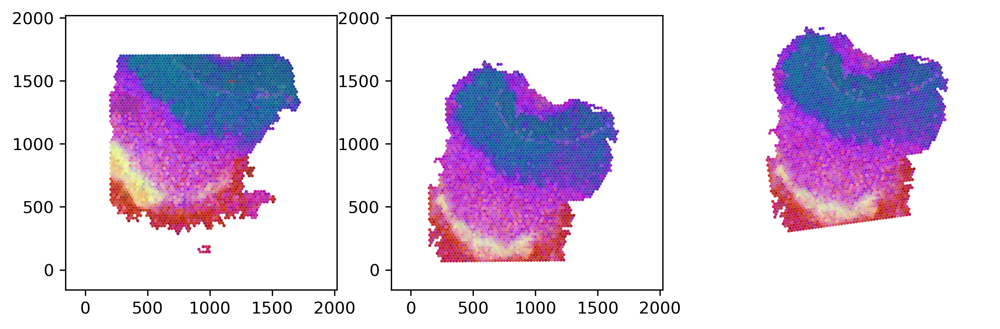

In [94]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

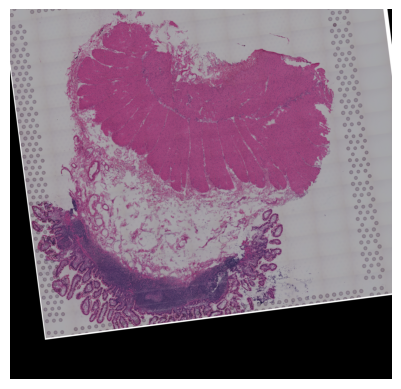

In [201]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [202]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [67]:
# generate_features_finetune10(src_sample_name)

In [95]:
case_name = '_finetune10'

In [96]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [97]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

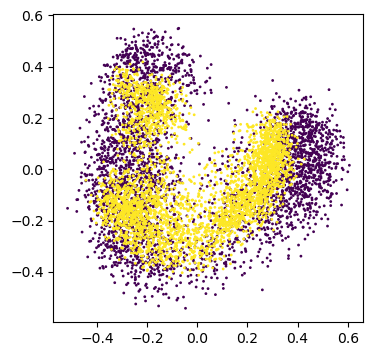

In [98]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [99]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [100]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [101]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

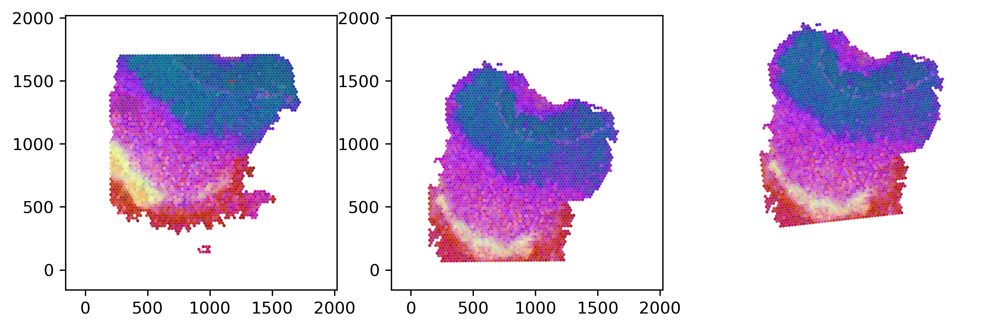

In [102]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

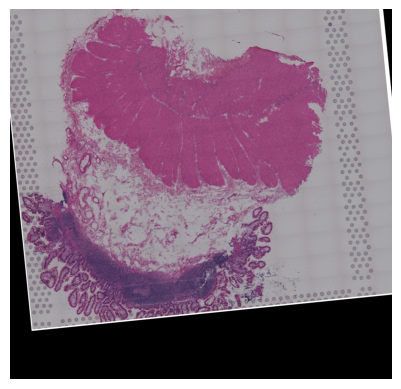

In [212]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [213]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [138]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [139]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [140]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


225

In [141]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3487/3487 [00:12<00:00, 290.49it/s]


In [142]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3487/3487 [00:47<00:00, 73.52it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


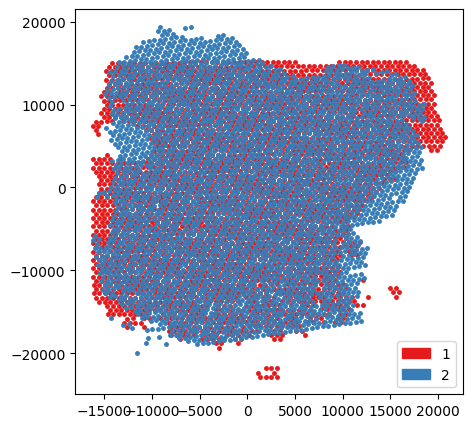

In [220]:
paste_align(src_sample_name)

In [103]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [104]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(179.67468910730162, 1562.1496233807638, 33.78014386224696, 1600.285171206406)

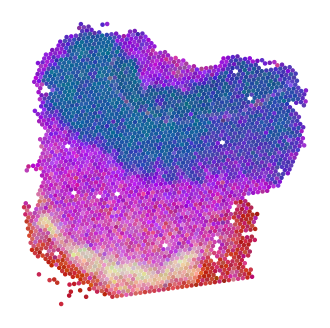

In [105]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [146]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3373/3373 [00:09<00:00, 351.36it/s]


In [147]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3373/3373 [00:43<00:00, 77.24it/s]


## GPSA

In [106]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(134.23339861592098,
 1802.2985053047819,
 316.84193400225087,
 1928.3475692922784)

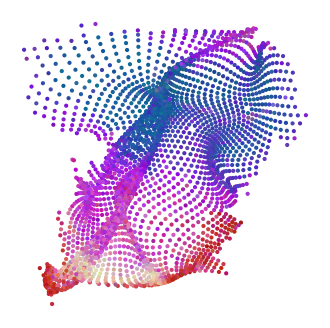

In [107]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)
plt.axis('off')

In [150]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3379/3379 [00:05<00:00, 601.87it/s]


In [151]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

197

In [152]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3379/3379 [00:54<00:00, 62.02it/s]


(3200, 2)

## Combine Analysis

In [161]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 197/197 [00:00<00:00, 865.46it/s]


In [162]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.286912,0.291938,0.366433,0.362899
MT-CO3,0.350278,0.360937,0.495673,0.459729
MT-CO1,0.360309,0.369735,0.534694,0.447717
CTSD,0.236001,0.189935,0.150676,0.302071
SERPINA1,0.319962,0.239449,0.190750,0.451231
...,...,...,...,...
TMEM159,0.013898,0.013462,0.019663,0.017458
DNAJC4,0.012392,0.012200,0.019109,0.015543
FYB1,0.013669,0.011987,0.018016,0.017726
TADA3,0.009736,0.009101,0.010212,0.012019


In [163]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [221]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

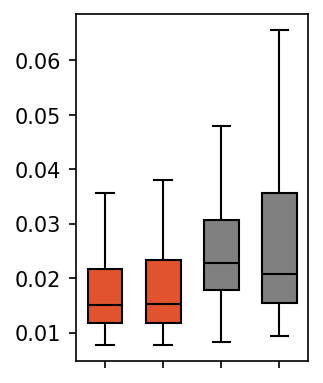

In [222]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey', 'grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [165]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.797615177396247, pvalue=8.028294160467118e-07)

In [166]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=5.5947846148944524, pvalue=1.1044791136410992e-08)

In [167]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.5118340949974604, pvalue=0.6956164369395264)

(0.0, 1.0)

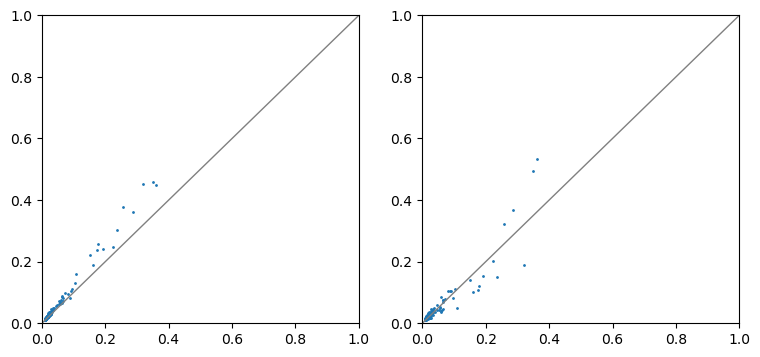

In [168]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_D1

In [223]:
src_sample_name = 'V10F24-048_D1'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


## Omiclip ST to ST

In [109]:
case_name = '_coca_after_training20'

In [110]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [111]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

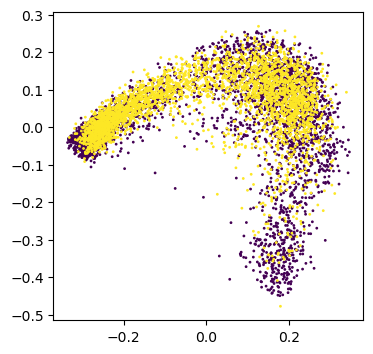

In [112]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [113]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [114]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [115]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [116]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

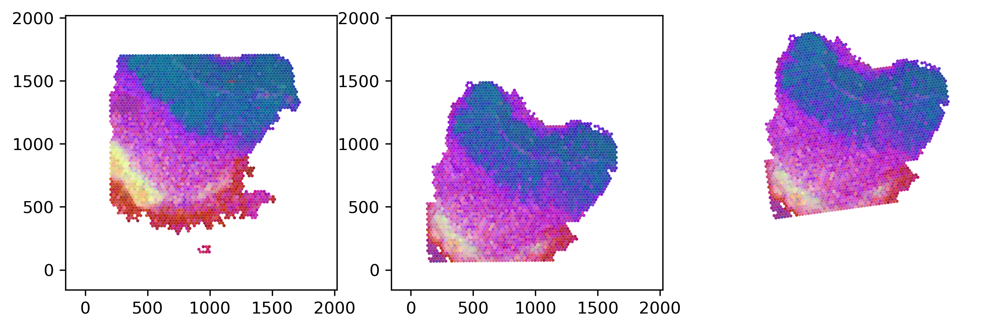

In [117]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

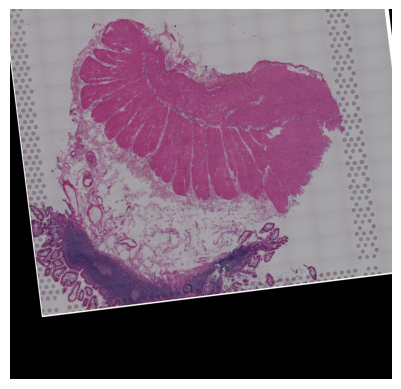

In [247]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [248]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [82]:
# generate_features_finetune10(src_sample_name)

In [118]:
case_name = '_finetune10'

In [119]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [120]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

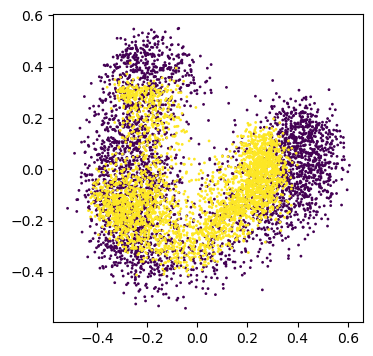

In [121]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [122]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [123]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [124]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

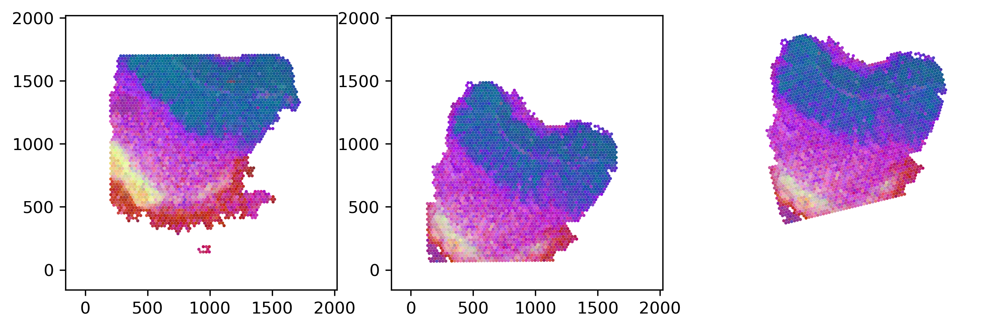

In [125]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

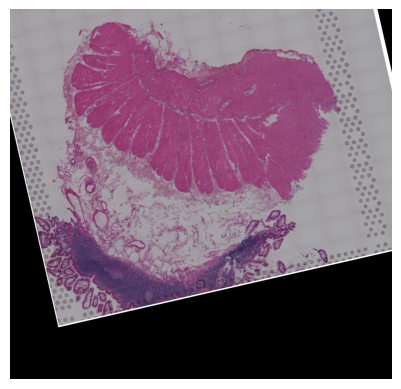

In [258]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [259]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [170]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [171]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:234: UserWarning: Some cells have zero counts
  warn(UserWarning("Some cells have zero counts"))


In [172]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


240

In [173]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3181/3181 [00:11<00:00, 287.47it/s]


In [174]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3181/3181 [00:43<00:00, 72.79it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


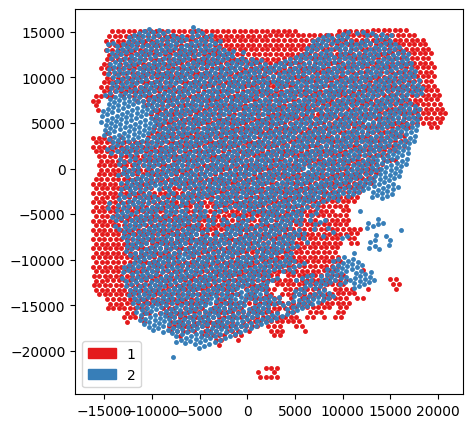

In [266]:
paste_align(src_sample_name)

In [126]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
paste_tar_ad = filter_norm_log1p(paste_tar_ad)
paste_align_ad = filter_norm_log1p(paste_align_ad)

In [127]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(212.086383321968, 1551.6230814020828, 11.354034588389695, 1456.1523797337368)

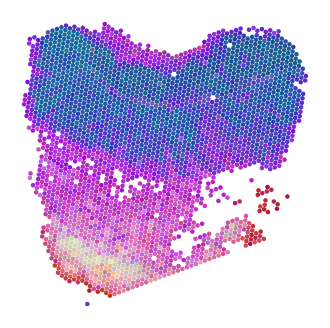

In [128]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [178]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 2836/2836 [00:08<00:00, 350.13it/s]


In [179]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 2836/2836 [00:37<00:00, 76.02it/s]


## GPSA

In [129]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

/condo/wanglab/hmaiwxc/anaconda3/envs/clip/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


(150.31156667422775,
 1728.8231845455794,
 -177.87046226518387,
 1829.5834466671856)

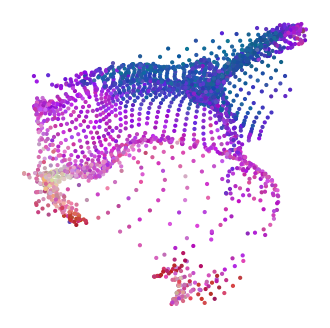

In [130]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)
plt.axis('off')

In [182]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 2857/2857 [00:04<00:00, 588.34it/s]


In [183]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

191

In [184]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 2857/2857 [00:42<00:00, 67.42it/s]


(2587, 2)

## Combine Analysis

In [204]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 191/191 [00:00<00:00, 887.02it/s]


In [205]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.448092,0.432361,0.316387,0.401444
MT-CO1,0.236954,0.240140,0.279582,0.261575
MYL9,0.350243,0.366649,0.411159,0.370146
CD74,0.294214,0.281441,0.293156,0.417113
CTSD,0.222146,0.222499,0.188832,0.440583
...,...,...,...,...
MARCKSL1,0.009873,0.010465,0.014032,0.015715
TRIM56,0.009045,0.009482,0.011379,0.011186
STX7,0.008253,0.008163,0.009319,0.009804
TMEM159,0.010260,0.010212,0.013552,0.014285


In [206]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [224]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

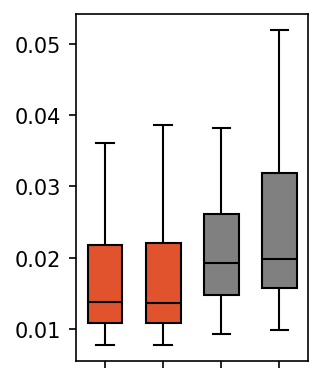

In [225]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey', 'grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [208]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=6.82126914684459, pvalue=4.511984586209158e-12)

In [209]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=6.108606151949748, pvalue=5.025250165790467e-10)

In [210]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.12093955895159554, pvalue=0.548130545696277)

(0.0, 1.0)

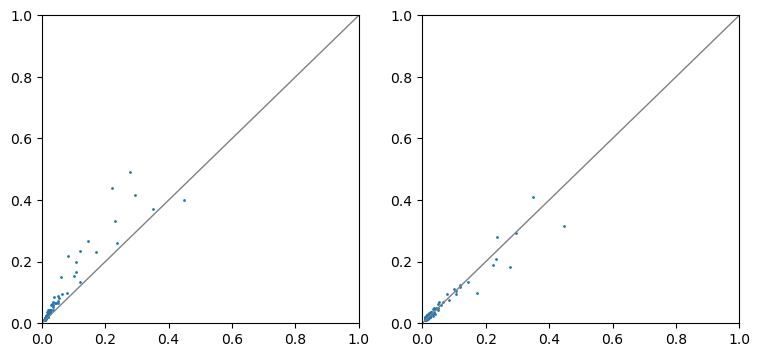

In [211]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_B1

In [226]:
src_sample_name = 'V10F24-048_B1'+'_rotate90'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [132]:
case_name = '_coca_after_training20'

In [133]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [134]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

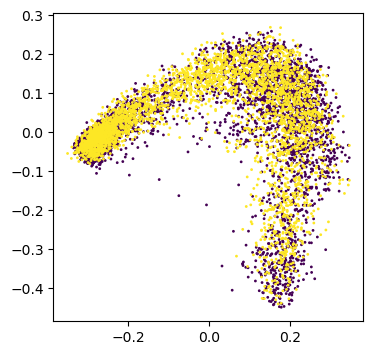

In [135]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [136]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [137]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [138]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [139]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

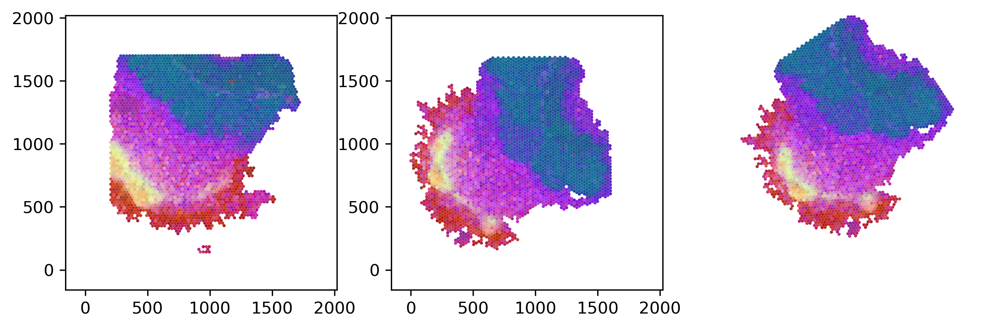

In [140]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

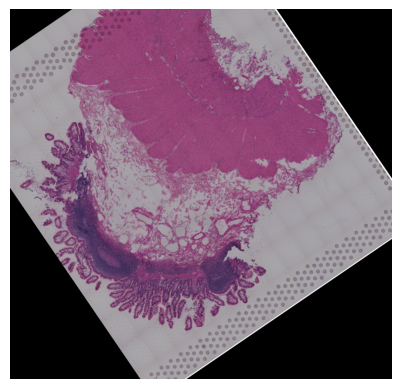

In [665]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [666]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [141]:
# generate_features_finetune10(src_sample_name)

In [142]:
case_name = '_finetune10'

In [143]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [144]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

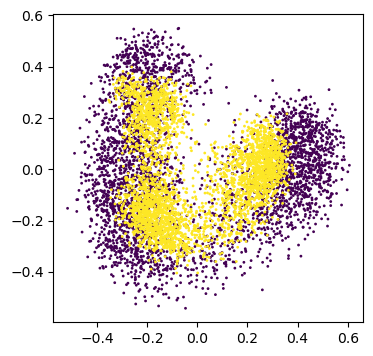

In [145]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [146]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [147]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [148]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

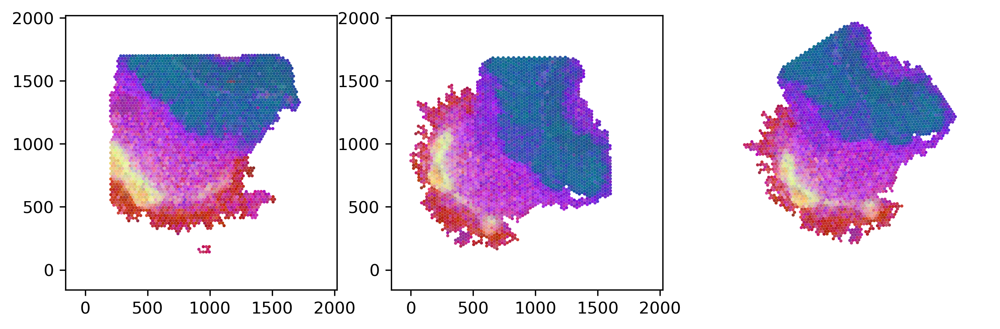

In [149]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

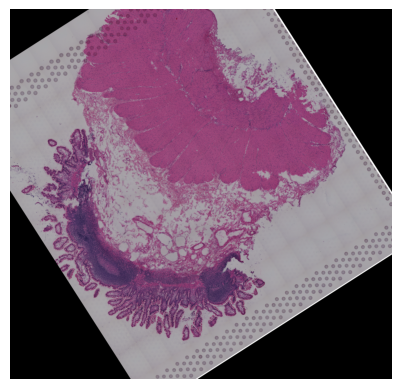

In [676]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [677]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [299]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [300]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [301]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


240

In [302]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3448/3448 [00:11<00:00, 287.42it/s]


In [303]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3448/3448 [00:47<00:00, 72.79it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


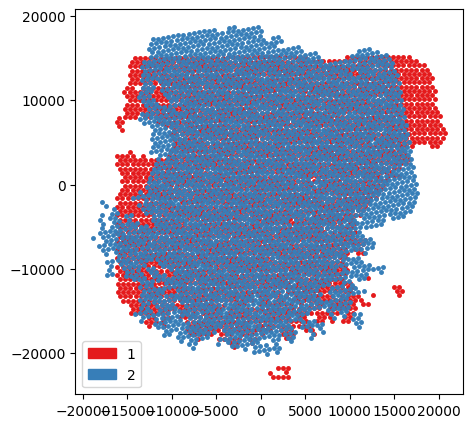

In [683]:
paste_align(src_sample_name)

In [150]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(paste_tar_ad)
sc.pp.normalize_total(paste_align_ad)
sc.pp.log1p(paste_tar_ad)
sc.pp.log1p(paste_align_ad)

In [151]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

(76.56950778804038, 1530.5979686632245, 28.503489860820096, 1575.7789843258893)

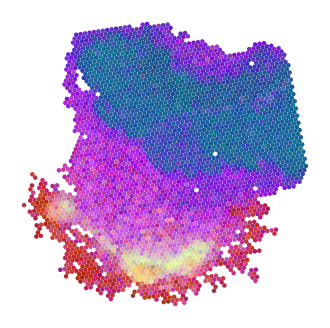

In [152]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [307]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3347/3347 [00:09<00:00, 356.02it/s]


In [308]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3347/3347 [00:43<00:00, 76.64it/s]


## GPSA

In [153]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

(-271.44772505093806,
 1806.700406208995,
 248.12508240346648,
 1668.1194166763642)

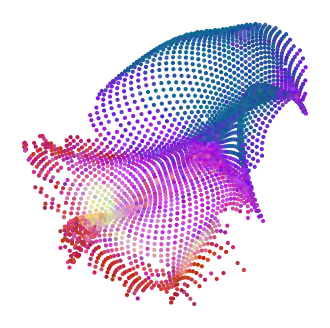

In [154]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)
plt.axis('off')

In [311]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3353/3353 [00:05<00:00, 618.44it/s]


In [312]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

213

In [313]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3353/3353 [00:49<00:00, 67.68it/s]


(3019, 2)

## Combine Analysis

In [322]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 213/213 [00:00<00:00, 864.08it/s]


In [323]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.368263,0.364687,0.575283,0.521772
MT-CO3,0.330940,0.322280,0.497087,0.427656
MYL9,0.196985,0.185686,0.265536,0.246509
CTSD,0.217580,0.224020,0.226847,0.331062
SERPINA1,0.319960,0.360123,0.310593,0.443378
...,...,...,...,...
AC037459.4,0.010813,0.012449,0.015190,0.015564
DDT,0.010480,0.011823,0.018195,0.013838
TMEM159,0.010868,0.011767,0.020075,0.014344
DNAJC4,0.011378,0.011151,0.015977,0.014650


In [324]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [227]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

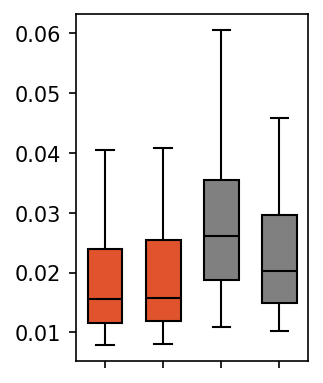

In [228]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey', 'grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [326]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.782451608752183, pvalue=8.658504190247364e-07)

In [327]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=8.348532122083235, pvalue=3.4558274589805404e-17)

In [328]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=0.297894829904172, pvalue=0.38289171702694835)

(0.0, 1.0)

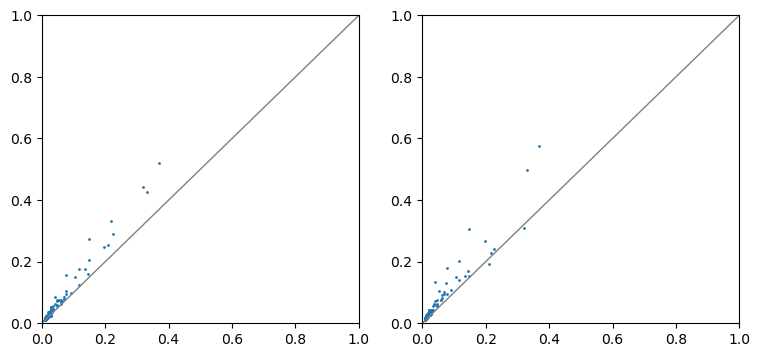

In [329]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

# V10F24-048_A1

In [229]:
src_sample_name = 'V10F24-048_A1'+'_rotate90'
ad_src, ad_src_coor, src_img =  prepare_data(src_sample_name)

## Omiclip ST to ST

In [156]:
case_name = '_coca_after_training20'

In [157]:
feature_type = '_coca_txt_features'
tar_features = get_features(tar_sample_name, feature_type, case_name)
src_features = get_features(src_sample_name, feature_type, case_name)

In [158]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

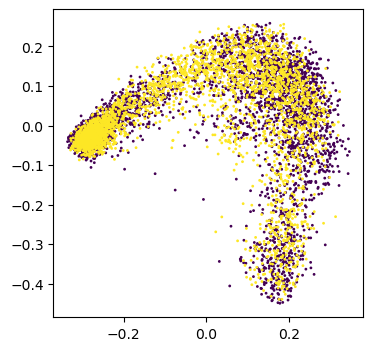

In [159]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [160]:
pca_rgb_comb = (pca_comb_features-pca_comb_features.min(axis=0))/(pca_comb_features.max(axis=0)-pca_comb_features.min(axis=0))
pca_rgb_comb[:,[0,1,2]]=pca_rgb_comb[:,[0,2,1]]
pca_hex_comb = [ rgb2hex(pca_rgb_comb[i,:]) for i in range(pca_rgb_comb.shape[0]) ]

In [161]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [162]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [163]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

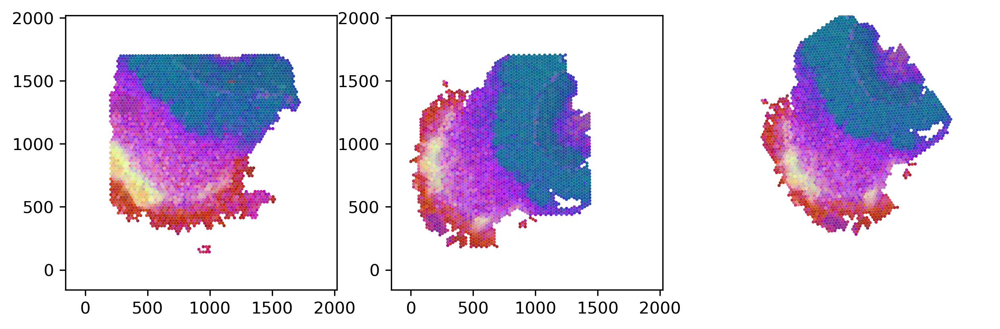

In [164]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

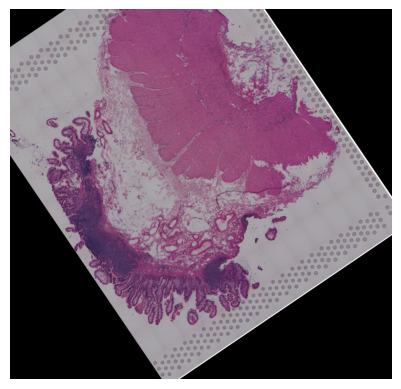

In [713]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [714]:
save_name = 'omiclip_st_st_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Img to ST

In [112]:
# generate_features_finetune10(src_sample_name)

In [165]:
case_name = '_finetune10'

In [166]:
tar_features = get_features(tar_sample_name, '_text_feature', case_name)
src_features = get_features(src_sample_name, '_image_feature', case_name)

In [167]:
pca_comb_features, pca_comb_features_batch = get_pca_by_fit(tar_features, src_features)

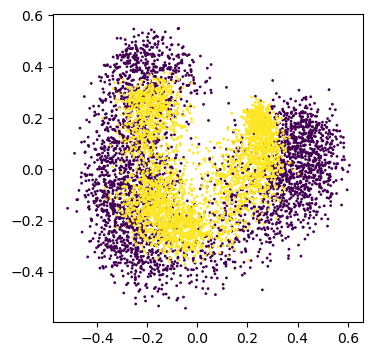

In [168]:
plt.figure(figsize=(4,4))
plt.scatter(pca_comb_features[:,0], pca_comb_features[:,1],c=pca_comb_features_batch, s=1)

In [169]:
alpha = 0.5
cpd_coor, homo_coor, aligned_image = cpd_align(ad_tar_coor, ad_src_coor, pca_comb_features, src_img, alpha)

In [170]:
# plot_alignment_with_img(ad_tar_coor, ad_src_coor, homo_coor, tar_img, src_img, aligned_image, pca_hex_comb, tar_features)

In [171]:
shift=300
s=0.8
# plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8)

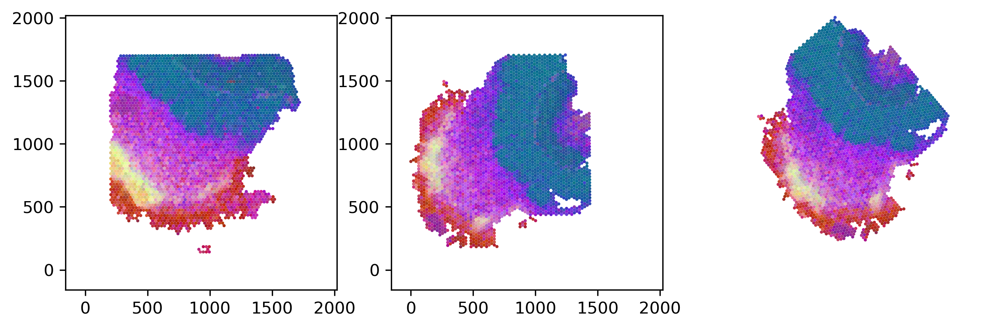

In [172]:
plot_alignment(ad_tar_coor, ad_src_coor, homo_coor, pca_hex_comb, tar_features, shift=300, s=0.8, boundary_line=False)

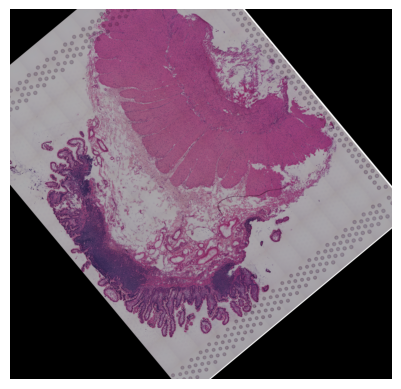

In [724]:
plt.imshow(aligned_image, origin='lower')
plt.axis('off')
plt.show()

In [725]:
save_name = 'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad'
wirte_aligned_data(ad_src, aligned_image, homo_coor, save_name)

## Omiclip Results

In [262]:
omiclip_ad_tar = ad_tar.copy()
omiclip_ad_src_align_st = sc.read_h5ad(case_dir_omiclip+'omiclip_st_st_'+src_sample_name+'.h5ad')
omiclip_ad_src_align_img_ft = sc.read_h5ad(case_dir_omiclip+'omiclip_st_img_finetune10_'+src_sample_name+'.h5ad')

In [263]:
omiclip_ad_tar = filter_norm_log1p(omiclip_ad_tar)
omiclip_ad_src_align_st = filter_norm_log1p(omiclip_ad_src_align_st)
omiclip_ad_src_align_img_ft = filter_norm_log1p(omiclip_ad_src_align_img_ft)

In [264]:
omiclip_ad_tar_heg_of_hvg = get_heg_of_hvg(omiclip_ad_tar, gene_num)
omiclip_ad_src_heg_of_hvg = get_heg_of_hvg(omiclip_ad_src_align_st, gene_num)
omiclip_genes = [value for value in omiclip_ad_tar_heg_of_hvg.index.tolist() if value in omiclip_ad_src_heg_of_hvg.index.tolist()]
len(omiclip_genes)

/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))
/tmp/ipykernel_1891117/1167307872.py:4: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  ad_hvg.var['mean_expression'] = np.ravel(ad_hvg.X.mean(0))


255

In [265]:
omiclip_ad_tar_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_tar)
omiclip_ad_src_align_mean_expr = get_mean_expr_by_neighbor(omiclip_ad_src_align_st)

100%|██████████| 3238/3238 [00:11<00:00, 282.52it/s]


In [266]:
scalef_tar = get_scalefactors(omiclip_ad_tar)['tissue_hires_scalef']
scalef_src = get_scalefactors(omiclip_ad_src_align_st)['tissue_hires_scalef']
omiclip_matches_st = nearest_neighbour(omiclip_ad_src_align_st.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)
omiclip_matches_img_ft = nearest_neighbour(omiclip_ad_src_align_img_ft.obsm['spatial']*scalef_src, omiclip_ad_tar.obsm['spatial']*scalef_tar)

Processing coordinates: 100%|██████████| 3238/3238 [00:44<00:00, 72.64it/s]


## Paste

Using selected backend cpu. If you want to use gpu, set use_gpu = True.


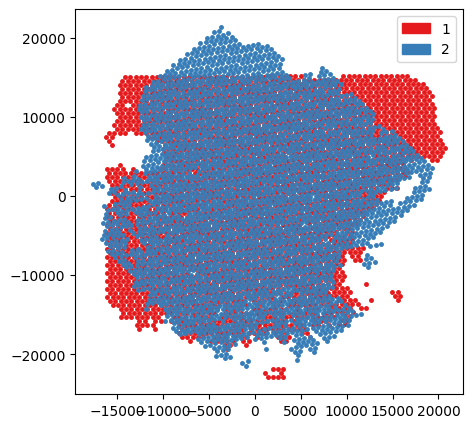

In [732]:
paste_align(src_sample_name)

In [173]:
paste_tar_ad = sc.read_h5ad(paste_path+'paste_aligment_target_'+src_sample_name+'.h5ad')
paste_align_ad = sc.read_h5ad(paste_path+'paste_aligment_source_'+src_sample_name+'.h5ad')
sc.pp.normalize_total(paste_tar_ad)
sc.pp.normalize_total(paste_align_ad)
sc.pp.log1p(paste_tar_ad)
sc.pp.log1p(paste_align_ad)

In [174]:
ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
paste_shared_index = find_matching_indices(ad_src.obs.index.to_list(), paste_align_ad.obs.index.to_list())
paste_tar_coor = (paste_tar_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())
paste_align_coor = (paste_align_ad.obsm['spatial']-paste_tar_ad.obsm['spatial'].min())/(paste_tar_ad.obsm['spatial'].max()-paste_tar_ad.obsm['spatial'].min())*(ad_tar_coor.max()-ad_tar_coor.min())

(119.73768600076757,
 1592.021000126378,
 -27.722777075106144,
 1679.1285022350435)

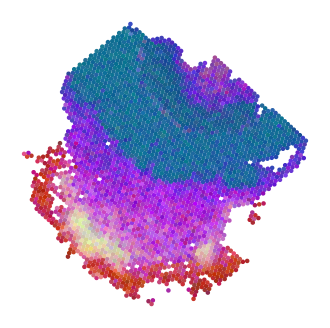

In [175]:
plt.figure(figsize=(4,4))
plt.scatter(paste_align_coor[:,0], paste_align_coor[:,1], s=5, c=[pca_hex_comb[len(tar_features.T):][i] for i in paste_shared_index[:,0]])
plt.axis('off')

In [270]:
paste_ad_tar_mean_expr = get_mean_expr_by_neighbor(paste_tar_ad)
paste_ad_src_align_mean_expr = get_mean_expr_by_neighbor(paste_align_ad)

100%|██████████| 3148/3148 [00:08<00:00, 356.92it/s]


In [271]:
paste_matches = nearest_neighbour(paste_align_coor, paste_tar_coor)

Processing coordinates: 100%|██████████| 3148/3148 [00:41<00:00, 76.71it/s]


## GPSA

In [176]:
gpsa_tar_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_target_'+src_sample_name+'.h5ad')
gpsa_align_ad = sc.read_h5ad(case_dir+'gpsa/gpsa_alignment_'+src_sample_name+'.h5ad')

gpsa_align = pd.read_csv(case_dir+'gpsa/gpsa_align_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_align = np.array(gpsa_align)
gpsa_tar = pd.read_csv(case_dir+'gpsa/gpsa_tar_coor_'+src_sample_name+'.csv', index_col=0)
gpsa_tar = np.array(gpsa_tar)

ad_src = sc.read_h5ad(os.path.join(data_dir, src_sample_name+'.h5ad'))
gpsa_shared_index = find_matching_indices(ad_src.obs.index.to_list(), gpsa_align_ad.obs.index.to_list())

gpsa_align_resize = (gpsa_align/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_tar_resize = (gpsa_tar/10)*(ad_tar_coor.max(axis=0)-ad_tar_coor.min(axis=0))+ad_tar_coor.min(axis=0)
gpsa_align_ad.obs[['newy', 'newx']] = gpsa_align_resize
gpsa_tar_ad.obs[['newy', 'newx']] = gpsa_tar_resize

(-163.4440618452727, 1833.0539608828635, 275.6374102108286, 1663.1618330317322)

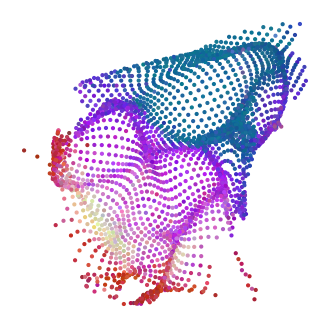

In [177]:
plt.figure(figsize=(4, 4))
plt.scatter(gpsa_align_resize[:,0], gpsa_align_resize[:,1], c = [pca_hex_comb[len(tar_features.T):][i] for i in gpsa_shared_index[:,0]],s=4)
plt.axis('off')

In [274]:
gpsa_ad_tar_mean_expr = get_mean_expr_by_dist(gpsa_tar_ad)
gpsa_ad_src_align_mean_expr = get_mean_expr_by_dist(gpsa_align_ad)

100%|██████████| 3150/3150 [00:05<00:00, 618.51it/s]


In [275]:
shared_genes = [value for value in omiclip_genes if value in gpsa_ad_tar_mean_expr.columns.tolist()]
shared_genes = [value for value in shared_genes if value in gpsa_ad_src_align_mean_expr.columns.tolist()]
len(shared_genes)

220

In [276]:
gpsa_matches = nearest_neighbour(gpsa_align_resize, gpsa_tar_resize)
gpsa_matches.shape

Processing coordinates: 100%|██████████| 3150/3150 [00:46<00:00, 67.66it/s]


(2881, 2)

## Combine Analysis

In [285]:
omiclip_st_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_st)
omiclip_img_ft_stat = calculate_mse(shared_genes, omiclip_ad_tar_mean_expr, omiclip_ad_src_align_mean_expr, omiclip_matches_img_ft)
paste_stat = calculate_mse(shared_genes, paste_ad_tar_mean_expr, paste_ad_src_align_mean_expr, paste_matches)
gpsa_stat = calculate_mse(shared_genes, gpsa_ad_tar_mean_expr, gpsa_ad_src_align_mean_expr, gpsa_matches)

100%|██████████| 220/220 [00:00<00:00, 877.62it/s]


In [286]:
all_mse = pd.concat([omiclip_st_stat['mse'], 
                     omiclip_img_ft_stat['mse'], 
                     gpsa_stat['mse'], 
                     paste_stat['mse'], 
                    ],axis=1)
all_mse.columns = ['omiclip_st','omiclip_img_ft','gpsa','paste']
all_mse

,omiclip_st,omiclip_img_ft,gpsa,paste
MT-ND4,0.222787,0.187662,0.271534,0.221367
MT-CO3,0.203768,0.198899,0.249004,0.218473
MYL9,0.169981,0.180659,0.274854,0.239003
CTSD,0.309767,0.260716,0.261073,0.292670
NACA,0.106571,0.099499,0.168565,0.125534
...,...,...,...,...
DNM2,0.012773,0.011803,0.016696,0.014820
DDT,0.012392,0.012689,0.022139,0.014260
FAM3C,0.011288,0.010994,0.017052,0.012856
TMEM159,0.010599,0.011886,0.018615,0.015786


In [287]:
all_mse.to_csv(case_dir+src_sample_name+'_all_mse.csv')

In [230]:
all_mse = pd.read_csv(case_dir+src_sample_name+'_all_mse.csv', index_col=0)

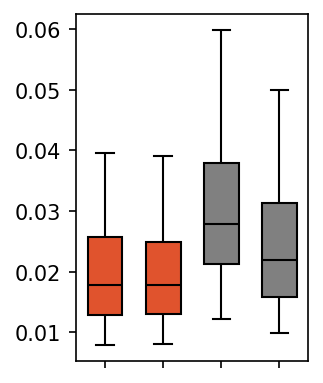

In [231]:
plt.figure(figsize=(2,3), dpi=150)
sns.boxplot(all_mse, showfliers=False, width=0.6, linecolor = 'black', linewidth=1, palette=['#FE420F','#FE420F','grey', 'grey'],)
plt.tick_params(labelbottom=False)    
# plt.ylim((0.05,0.4))

In [289]:
ranksums(all_mse['paste'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=4.306883047045728, pvalue=8.278554669039409e-06)

In [290]:
ranksums(all_mse['gpsa'], all_mse['omiclip_img_ft'], alternative='greater')

RanksumsResult(statistic=8.711990620408132, pvalue=1.4929219699282625e-18)

In [291]:
ranksums(all_mse['omiclip_img_ft'], all_mse['omiclip_st'], alternative='greater')

RanksumsResult(statistic=-0.07273113780700481, pvalue=0.528989965114187)

(0.0, 1.0)

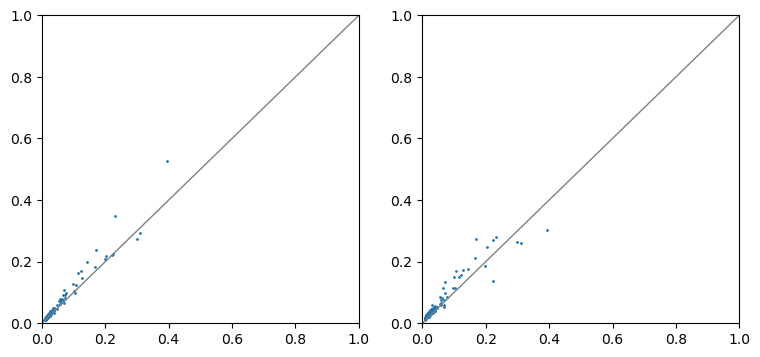

In [292]:
plt.figure(figsize=(9,4))
plt.subplot(1, 2, 1)
plt.scatter(all_mse['omiclip_st'], all_mse['paste'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))

plt.subplot(1, 2, 2)
plt.scatter(all_mse['omiclip_st'], all_mse['gpsa'], s=1)
plt.plot([0,2],[0,2], linewidth=1, c='grey')
plt.xlim((0,1))
plt.ylim((0,1))